# Lecture 20 - Line Charts, Bar Charts, and Scatter Plots

Wednesday 2021/04/07

---

## ✨ Visualize your dataset

▶️ First, run the code cell below to import modules used for **🧭 Check Your Work** sections and the autograder.

In [1]:
import unittest
import base64
import plotly
tc = unittest.TestCase()

---

### 🎯 Pre-exercise: Import Packages

#### 👇 Tasks

- ✔️ Import the following Python packages.
    1. `pandas`: Use alias `pd`.
    2. `numpy`: Use alias `np`.
    3. `plotly.express`: Use alias `px`.
    4. `plotly.graph_objects`: Use alias `go`.

In [2]:
# YOUR CODE BEGINS
import pandas as pd
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
# YOUR CODE ENDS

#### 🧭 Check your work

- Once you're done, run the code cell below to test correctness.
- ✔️ If the code cell runs without an error, you're good to move on.
- ❌ If the code cell throws an error, go back and fix incorrect parts.

In [3]:
import sys
tc.assertTrue('pd' in globals(), 'Check whether you have correctly imported Pandas with an alias.')
tc.assertTrue('np' in globals(), 'Check whether you have correctly imported NumPy with an alias.')
tc.assertIsNotNone(go.Figure, 'Check whether you have correctly imported plotly.graph_objects with an alias go.')
tc.assertIsNotNone(px.scatter, 'Check whether you have correctly imported plotly.express with an alias px.')

---
### 📌 Import dataset

![BLUEbikes](https://github.com/bdi475/images/blob/main/lecture-notes/dataviz-python/bluebike-transparent-bike.png?raw=true)

Today, we work with bikesharing trips dataset 🚲 to uncover insights about trips made by subscribers and casual riders of Bluebikes (in Boston). The original dataset has been downloaded from [https://www.bluebikes.com/system-data](https://www.bluebikes.com/system-data) and was preprocessed for this exercise.

▶️ Run the code below to import the dataset. This dataset is a fairly large with ~2 million rows, **so it may take up to a few minutes**.

In [4]:
# Display all columns
pd.set_option('display.max_columns', 50)

df_trips = pd.read_csv('https://github.com/bdi475/datasets/blob/main/bluebikes-trip-data-2020-sampled.csv.gz?raw=true',
                       compression='gzip',
                       parse_dates=['start_time', 'stop_time'])

df_trips_backup = df_trips.copy()

display(df_trips)

,trip_duration,start_station_name,end_station_name,user_type,start_time,stop_time
0,344,175 N Harvard St,Harvard Kennedy School at Bennett St / Eliot St,Customer,2020-08-06 16:52:57,2020-08-06 16:58:42
1,451,Harvard University River Houses at DeWolfe St ...,175 N Harvard St,Subscriber,2020-08-04 10:43:49,2020-08-04 10:51:21
2,750,Prudential Center - 101 Huntington Ave,Central Sq Post Office / Cambridge City Hall a...,Subscriber,2020-01-19 18:44:08,2020-01-19 18:56:38
3,1422,Cambridge St - at Columbia St / Webster Ave,Mass Ave T Station,Customer,2020-08-15 18:11:50,2020-08-15 18:35:32
4,3405,Mattapan T Stop,Mattapan T Stop,Subscriber,2020-01-11 12:51:52,2020-01-11 13:48:37
...,...,...,...,...,...,...
199995,255,MIT Vassar St,MIT Stata Center at Vassar St / Main St,Subscriber,2020-03-04 15:54:25,2020-03-04 15:58:41
199996,1451,Farragut Rd at E. 6th St,Aquarium T Stop - 200 Atlantic Ave,Subscriber,2020-07-07 20:20:51,2020-07-07 20:45:03
199997,454,Harvard Square at Mass Ave/ Dunster,Lesley University,Subscriber,2020-09-21 15:33:06,2020-09-21 15:40:41
199998,322,Harvard Law School at Mass Ave / Jarvis St,Verizon Innovation Hub 10 Ware Street,Subscriber,2020-02-05 17:07:50,2020-02-05 17:13:13


--- 

## 📦 Box plots and histograms review

---

### 🎯 Exercise 1: Trip duration box plot (horizontal)

#### 👇 Tasks

- ✔️ Draw a horizontal box plot of `trip_duration` where `trip_duration < 1800` (less than 30 minutes).
- ✔️ Store your figure to a variable named `fig`.
- ✔️ Add an appropriate title to your figure.
- ✔️ Display the figure using `fig.show()`

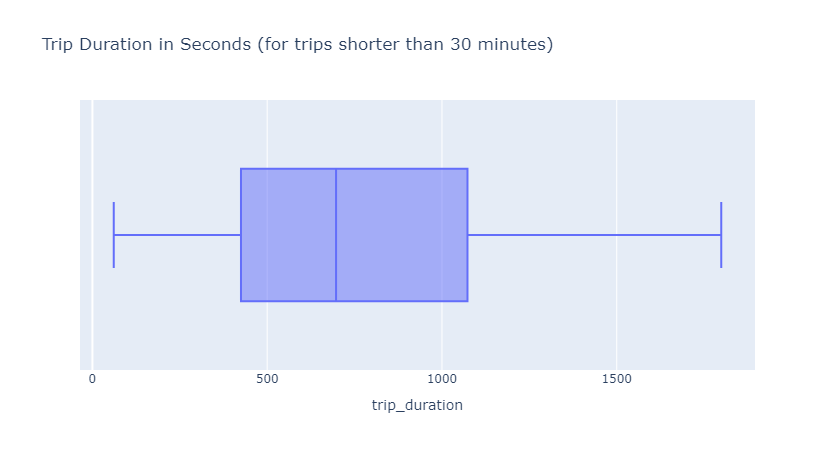

In [5]:
# YOUR CODE BEGINS
fig = px.box(df_trips[df_trips['trip_duration'] < 1800],
             x='trip_duration',
             orientation='h',
             title='Trip Duration in Seconds (for trips shorter than 30 minutes)')
fig.show()
# YOUR CODE ENDS

#### 🧭 Check your work

- Once you're done, run the code cell below to test correctness.
- ✔️ If the code cell runs without an error, you're good to move on.
- ❌ If the code cell throws an error, go back and fix incorrect parts.

In [6]:
tc.assertEqual(len(fig.data), 1, 'There must be only one plot in your figure')
tc.assertIsNotNone(fig.layout.title.text, 'Missing figure title')
tc.assertEqual(fig.data[0].type, 'box', 'Not a box plot')
tc.assertEqual(fig.data[0].orientation, 'h', 'Your plot should have a horizontal orientation')
np.testing.assert_array_equal(fig.data[0].x, df_trips['trip_duration'][df_trips['trip_duration'] < 1800], 'Incorrect data')

---

### 🎯 Exercise 2: Trip duration dispersion by user type

#### 👇 Tasks

- ✔️ Draw horizontal box plots of `trip_duration` by `user_type`.
- ✔️ Store your figure to a variable named `fig`.
- ✔️ Add an appropriate title to your figure.
- ✔️ Display the figure using `fig.show()`

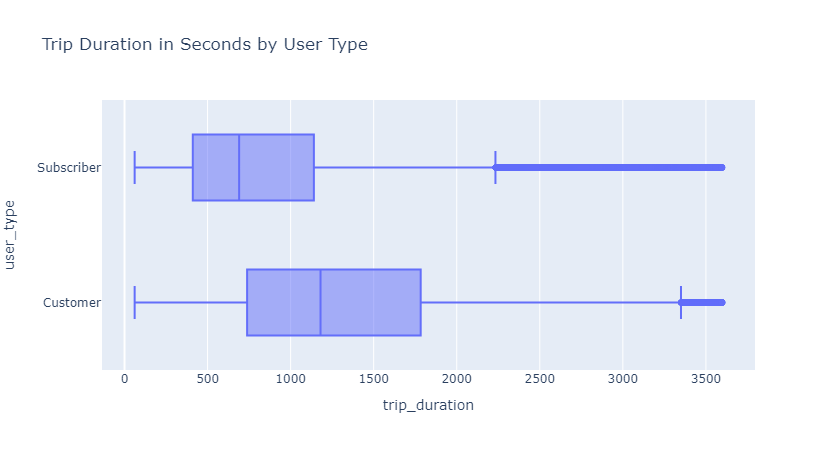

In [7]:
# YOUR CODE BEGINS
fig = px.box(df_trips,
             x='trip_duration',
             y='user_type',
             orientation='h',
             title='Trip Duration in Seconds by User Type')
fig.show()
# YOUR CODE ENDS

#### 🧭 Check your work

- Once you're done, run the code cell below to test correctness.
- ✔️ If the code cell runs without an error, you're good to move on.
- ❌ If the code cell throws an error, go back and fix incorrect parts.

In [8]:
tc.assertEqual(len(fig.data), 1, 'There must be only one plot in your figure')
tc.assertIsNotNone(fig.layout.title.text, 'Missing figure title')
tc.assertEqual(fig.data[0].type, 'box', 'Not a box plot')
tc.assertEqual(fig.data[0].orientation, 'h', 'Your plot should have a horizontal orientation')
np.testing.assert_array_equal(fig.data[0].x, df_trips['trip_duration'], 'Incorrect x-axis data')
np.testing.assert_array_equal(fig.data[0].y, df_trips['user_type'], 'Incorrect y-axis data')

---

### 🎯 Exercise 3: Trip duration histogram

#### 👇 Tasks

- ✔️ Draw a histogram of `trip_duration` in `df_trips`.
- ✔️ Set the number of bins to `36`.
- ✔️ Store your figure to a variable named `fig`.
- ✔️ Add an appropriate title to your figure.
- ✔️ Display the figure using `fig.show()`

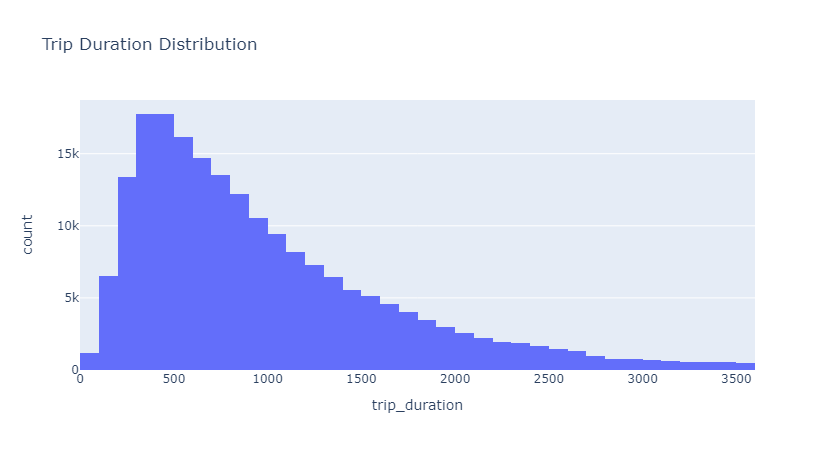

In [9]:
# YOUR CODE BEGINS
fig = px.histogram(df_trips, x='trip_duration', title='Trip Duration Distribution', nbins=36)
fig.show()
# YOUR CODE ENDS

#### 🧭 Check your work

- Once you're done, run the code cell below to test correctness.
- ✔️ If the code cell runs without an error, you're good to move on.
- ❌ If the code cell throws an error, go back and fix incorrect parts.

In [10]:
tc.assertEqual(len(fig.data), 1, 'There must be only one plot in your figure')
tc.assertIsNotNone(fig.layout.title.text, 'Missing figure title')
tc.assertEqual(fig.data[0].type, 'histogram', 'Not a histogram')
tc.assertEqual(fig.data[0].nbinsx, 36, 'There should be 36 bins - set the nbins parameter')
tc.assertEqual(fig.data[0].orientation, 'v', 'Your plot should have a vertical orientation')
np.testing.assert_array_equal(fig.data[0].x, df_trips['trip_duration'], 'Incorrect data')

--- 

## 📈 Line chart

A line chart displays the evolution of one or more numeric variables. Discrete data points are usually connected by straight lines.

---

### 🎯 Exercise 4: Annual gold price at the end of the year 📈

▶️ First, run the code cell below to import annual gold closing prices dataset.

In [11]:
# DO NOT CHANGE THE CODE BELOW
df_gold = pd.read_csv('https://github.com/bdi475/datasets/raw/main/gold-annual-closing-price.csv')
df_gold

,Year,Closing Price
0,1950,34.720
1,1951,34.660
2,1952,34.790
3,1953,34.850
4,1954,35.040
...,...,...
66,2016,1152.165
67,2017,1265.674
68,2018,1249.887
69,2019,1480.025


#### 👇 Tasks

- ✔️ Using `df_gold`, create a line chart that displays the closing price by year.
- ✔️ Store your figure to a variable named `fig`.
- ✔️ Add an appropriate title to your figure.
- ✔️ Display the figure using `fig.show()`

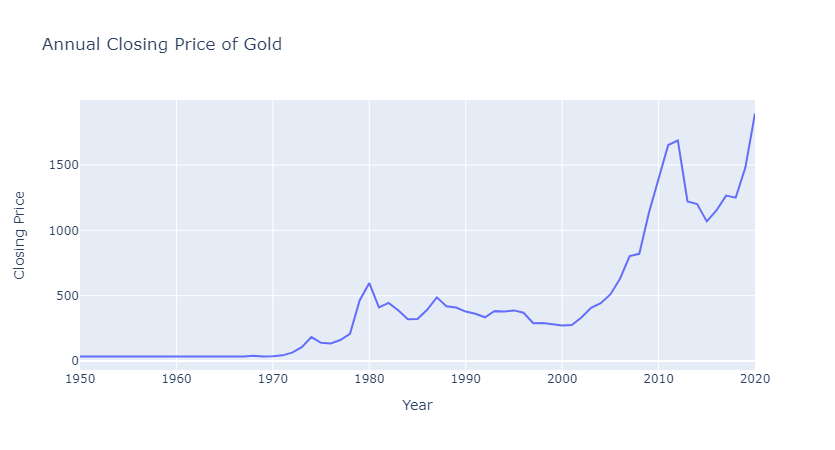

In [12]:
# YOUR CODE BEGINS
fig = px.line(df_gold, x='Year', y='Closing Price', title='Annual Closing Price of Gold')
fig.show()
# YOUR CODE ENDS

#### 🧭 Check your work

- Once you're done, run the code cell below to test correctness.
- ✔️ If the code cell runs without an error, you're good to move on.
- ❌ If the code cell throws an error, go back and fix incorrect parts.

In [13]:
tc.assertEqual(len(fig.data), 1, 'There must be only one plot in your figure')
tc.assertIsNotNone(fig.layout.title.text, 'Missing figure title')
tc.assertEqual(fig.data[0].type, 'scatter', 'Must be a line chart')
tc.assertIsNotNone(fig.data[0].line.color, 'Must be a line chart')
np.testing.assert_array_equal(fig.data[0].x, df_gold['Year'], 'Incorrect x-axis data')
np.testing.assert_array_equal(fig.data[0].y, df_gold['Closing Price'], 'Incorrect y-axis data')

---
### 🎯 Exercise 5: Create an aggregated DataFrame with number of trips by date

#### 👇 Tasks

- ✔️ One of the common tasks when visualizing your data is to aggregate your data before plotting them.
- ✔️ Using `df_trips`, create a new DataFrame named `df_num_trips_by_date` that holds the number of trips by date.
- ✔️ We will give you the fully working code below.


![Code](https://github.com/bdi475/images/blob/3e25d254f4d5f9c13c82cadd7f1c999a82e37d15/lecture-notes/dataviz-python/carbon-groupby-num-trips-by-date-01.png?raw=true)

In [14]:
### YOUR CODE BEGINS
df_num_trips_by_date = df_trips.groupby(
    df_trips['start_time'].dt.date,
    as_index=False
).size()

df_num_trips_by_date.rename(columns={
    'start_time': 'date',
    'size': 'num_trips'
}, inplace=True)

display(df_num_trips_by_date)
### YOUR CODE ENDS

,date,num_trips
0,2020-01-01,156
1,2020-01-02,364
2,2020-01-03,421
3,2020-01-04,160
4,2020-01-05,214
...,...,...
330,2020-11-26,153
331,2020-11-27,411
332,2020-11-28,429
333,2020-11-29,443


#### 🧭 Check your work

- Once you're done, run the code cell below to test correctness.
- ✔️ If the code cell runs without an error, you're good to move on.
- ❌ If the code cell throws an error, go back and fix incorrect parts.

In [15]:
df_check = df_trips_backup.groupby(df_trips_backup['start_time'].dt.date).size() \
    .reset_index().rename(columns={'start_time': 'date', 0: 'num_trips'})

pd.testing.assert_frame_equal(df_num_trips_by_date.sort_values('date').reset_index(drop=True),
                              df_check.sort_values('date').reset_index(drop=True),)

---

### 🎯 Exercise 6: Number of trips by date 📈

#### 👇 Tasks

- ✔️ Using `df_num_trips_by_date`, create a line chart that displays the number of trips by date.
- ✔️ Store your figure to a variable named `fig`.
- ✔️ Add an appropriate title to your figure.
- ✔️ Display the figure using `fig.show()`

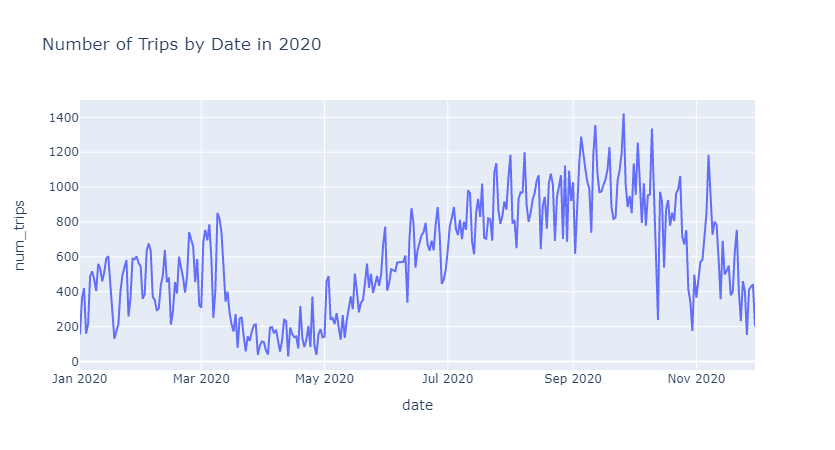

In [16]:
# YOUR CODE BEGINS
fig = px.line(df_num_trips_by_date, x='date', y='num_trips', title='Number of Trips by Date in 2020')
fig.show()
# YOUR CODE ENDS

#### 🧭 Check your work

- Once you're done, run the code cell below to test correctness.
- ✔️ If the code cell runs without an error, you're good to move on.
- ❌ If the code cell throws an error, go back and fix incorrect parts.

In [17]:
tc.assertEqual(len(fig.data), 1, 'There must be only one plot in your figure')
tc.assertIsNotNone(fig.layout.title.text, 'Missing figure title')
tc.assertEqual(fig.data[0].type, 'scatter', 'Must be a line chart')
tc.assertIsNotNone(fig.data[0].line.color, 'Must be a line chart')
np.testing.assert_array_equal(fig.data[0].x, df_num_trips_by_date['date'], 'Incorrect x-axis data')
np.testing.assert_array_equal(fig.data[0].y, df_num_trips_by_date['num_trips'], 'Incorrect y-axis data')

---

### 🎯 Exercise 7: Number of trips by date (Scatter Plot)

#### 👇 Tasks

- ✔️ Using `df_num_trips_by_date`, create a **scatter** plot that displays the number of trips by date.
- ✔️ Store your figure to a variable named `fig`.
- ✔️ Add an appropriate title to your figure.
- ✔️ Display the figure using `fig.show()`

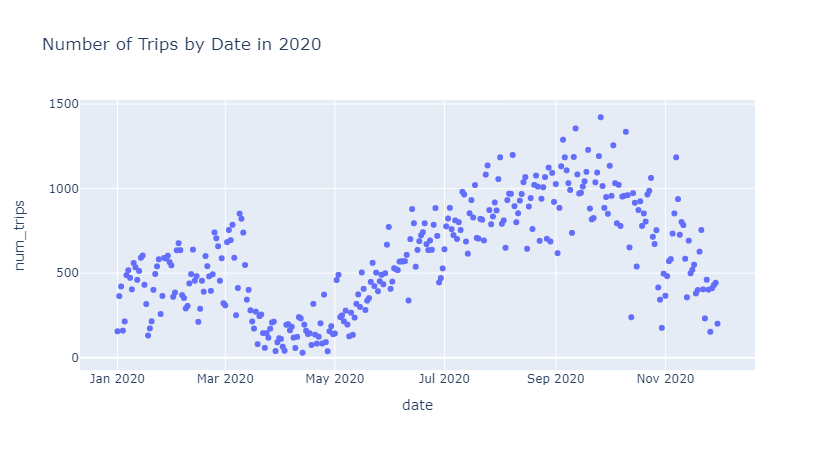

In [18]:
# YOUR CODE BEGINS
fig = px.scatter(df_num_trips_by_date, x='date', y='num_trips', title='Number of Trips by Date in 2020')
fig.show()
# YOUR CODE ENDS

#### 🧭 Check your work

- Once you're done, run the code cell below to test correctness.
- ✔️ If the code cell runs without an error, you're good to move on.
- ❌ If the code cell throws an error, go back and fix incorrect parts.

In [19]:
tc.assertEqual(len(fig.data), 1, 'There must be only one plot in your figure')
tc.assertIsNotNone(fig.layout.title.text, 'Missing figure title')
tc.assertEqual(fig.data[0].type, 'scatter', 'Must be a scatter plot')
tc.assertIsNone(fig.data[0].line.color, 'Must be a scatter plot')
np.testing.assert_array_equal(fig.data[0].x, df_num_trips_by_date['date'], 'Incorrect x-axis data')
np.testing.assert_array_equal(fig.data[0].y, df_num_trips_by_date['num_trips'], 'Incorrect y-axis data')

---
### 🎯 Exercise 8: Create an aggregated DataFrame with number of trips by date & user type

#### 👇 Tasks

- ✔️ Using `df_trips`, create a new DataFrame named `df_num_trips_by_date_and_user_type` that holds the number of trips by date and user type.
- ✔️ We will give you the fully working code below.


![Code](https://github.com/bdi475/images/blob/main/lecture-notes/dataviz-python/carbon-groupby-num-trips-and-user-type-by-date-01.png?raw=true)

In [20]:
# YOUR CODE BEGINS
df_num_trips_by_date_and_user_type = df_trips.groupby(
    [df_trips['start_time'].dt.date, 'user_type'],
    as_index=False
).size()

df_num_trips_by_date_and_user_type.rename(columns={
    'start_time': 'date',
    'size': 'num_trips'
}, inplace=True)

display(df_num_trips_by_date_and_user_type)
# YOUR CODE ENDS

,date,user_type,num_trips
0,2020-01-01,Customer,36
1,2020-01-01,Subscriber,120
2,2020-01-02,Customer,38
3,2020-01-02,Subscriber,326
4,2020-01-03,Customer,49
...,...,...,...
665,2020-11-28,Subscriber,312
666,2020-11-29,Customer,115
667,2020-11-29,Subscriber,328
668,2020-11-30,Customer,18


#### 🧭 Check your work

- Once you're done, run the code cell below to test correctness.
- ✔️ If the code cell runs without an error, you're good to move on.
- ❌ If the code cell throws an error, go back and fix incorrect parts.

In [21]:
df_check = df_trips_backup.groupby([df_trips_backup['start_time'].dt.date, 'user_type']).size() \
    .reset_index().rename(columns={'start_time': 'date', 0: 'num_trips'})

pd.testing.assert_frame_equal(df_num_trips_by_date_and_user_type.sort_values(['date', 'user_type']).reset_index(drop=True),
                              df_check.sort_values(['date', 'user_type']).reset_index(drop=True),)

---

### 🎯 Exercise 9: Number of trips by date and user type

#### 👇 Tasks

- ✔️ Using `df_num_trips_by_date_and_user_type`, create a **line** chart that displays the number of trips by date.
- ✔️ Draw two line charts on a single figure.
    - Use different colors to distinguish the user types.
- ✔️ Store your figure to a variable named `fig`.
- ✔️ Add an appropriate title to your figure.
- ✔️ Display the figure using `fig.show()`

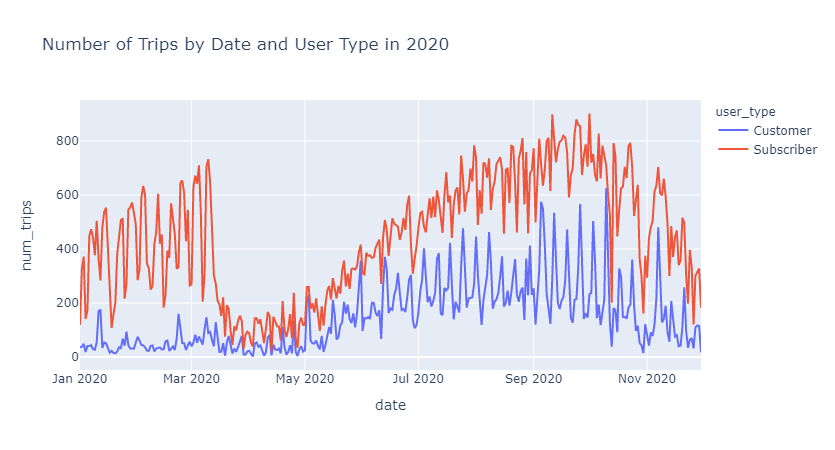

In [22]:
# YOUR CODE BEGINS
fig = px.line(df_num_trips_by_date_and_user_type,
                 x='date',
                 y='num_trips',
                 color='user_type',
                 title='Number of Trips by Date and User Type in 2020')
fig.show()
# YOUR CODE ENDS

#### 🧭 Check your work

- Once you're done, run the code cell below to test correctness.
- ✔️ If the code cell runs without an error, you're good to move on.
- ❌ If the code cell throws an error, go back and fix incorrect parts.

In [23]:
tc.assertEqual(len(fig.data), 2, 'There must be two plots in your figure')
tc.assertIsNotNone(fig.layout.title.text, 'Missing figure title')
tc.assertEqual(fig.data[0].type, 'scatter', 'Must be a line plot')
tc.assertEqual(fig.data[1].type, 'scatter', 'Must be a line plot')
tc.assertIsNotNone(fig.data[0].line.color, 'Must be a line plot')
tc.assertIsNotNone(fig.data[1].line.color, 'Must be a line plot')
np.testing.assert_array_equal(
    fig.data[0].x,
    df_num_trips_by_date_and_user_type[df_num_trips_by_date_and_user_type['user_type'] == 'Customer']['date'],
    'Incorrect x-axis data'
)
np.testing.assert_array_equal(
    fig.data[0].y,
    df_num_trips_by_date_and_user_type[df_num_trips_by_date_and_user_type['user_type'] == 'Customer']['num_trips'],
    'Incorrect y-axis data'
)

np.testing.assert_array_equal(
    fig.data[1].x,
    df_num_trips_by_date_and_user_type[df_num_trips_by_date_and_user_type['user_type'] == 'Subscriber']['date'],
    'Incorrect x-axis data'
)
np.testing.assert_array_equal(
    fig.data[1].y,
    df_num_trips_by_date_and_user_type[df_num_trips_by_date_and_user_type['user_type'] == 'Subscriber']['num_trips'],
    'Incorrect y-axis data'
)

---

### 🎯 Exercise 10: Number of trips by date and user type (scatter plot)

#### 👇 Tasks

- ✔️ Using `df_num_trips_by_date_and_user_type`, create a **scatter** plot that displays the number of trips by date.
- ✔️ Draw two scatter plots on a single figure.
    - Use different colors to distinguish the user types.
- ✔️ Store your figure to a variable named `fig`.
- ✔️ Add an appropriate title to your figure.
- ✔️ Display the figure using `fig.show()`

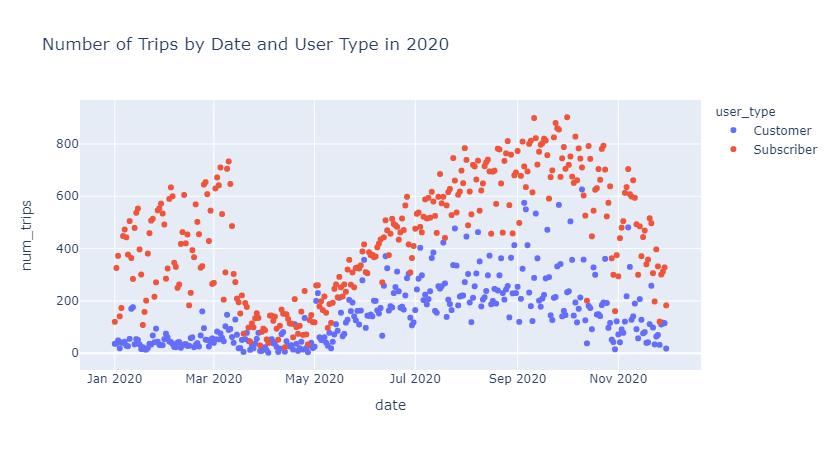

In [24]:
# YOUR CODE BEGINS
fig = px.scatter(df_num_trips_by_date_and_user_type,
                 x='date',
                 y='num_trips',
                 color='user_type',
                 title='Number of Trips by Date and User Type in 2020')
fig.show()
# YOUR CODE ENDS

#### 🧭 Check your work

- Once you're done, run the code cell below to test correctness.
- ✔️ If the code cell runs without an error, you're good to move on.
- ❌ If the code cell throws an error, go back and fix incorrect parts.

In [25]:
tc.assertEqual(len(fig.data), 2, 'There must be two plots in your figure')
tc.assertIsNotNone(fig.layout.title.text, 'Missing figure title')
tc.assertEqual(fig.data[0].type, 'scatter', 'Must be a scatter plot')
tc.assertEqual(fig.data[1].type, 'scatter', 'Must be a scatter plot')
tc.assertIsNone(fig.data[0].line.color, 'Must be a scatter plot')
tc.assertIsNone(fig.data[1].line.color, 'Must be a scatter plot')
np.testing.assert_array_equal(
    fig.data[0].x,
    df_num_trips_by_date_and_user_type[df_num_trips_by_date_and_user_type['user_type'] == 'Customer']['date'],
    'Incorrect x-axis data'
)
np.testing.assert_array_equal(
    fig.data[0].y,
    df_num_trips_by_date_and_user_type[df_num_trips_by_date_and_user_type['user_type'] == 'Customer']['num_trips'],
    'Incorrect y-axis data'
)

np.testing.assert_array_equal(
    fig.data[1].x,
    df_num_trips_by_date_and_user_type[df_num_trips_by_date_and_user_type['user_type'] == 'Subscriber']['date'],
    'Incorrect x-axis data'
)
np.testing.assert_array_equal(
    fig.data[1].y,
    df_num_trips_by_date_and_user_type[df_num_trips_by_date_and_user_type['user_type'] == 'Subscriber']['num_trips'],
    'Incorrect y-axis data'
)

--- 

## 📊 Bar chart

A bar chart displays size of the values of categorical data.

---
### 🎯 Exercise 11: Create an aggregated DataFrame with number of trips by month

#### 👇 Tasks

- ✔️ Using `df_trips`, create a new DataFrame named `df_num_trips_by_month` that holds the number of trips by month.
- ✔️ We will give you the fully working code below.


![Code](https://github.com/bdi475/images/blob/main/lecture-notes/dataviz-python/carbon-groupby-num-trips-by-month-01.png?raw=true)

In [26]:
# YOUR CODE BEGINS
df_num_trips_by_month = df_trips.groupby(
    df_trips['start_time'].dt.month,
    as_index=False
).size()

df_num_trips_by_month.rename(columns={
    'start_time': 'month',
    'size': 'num_trips'
}, inplace=True)

display(df_num_trips_by_month)
# YOUR CODE ENDS

,month,num_trips
0,1,13256
1,2,13850
2,3,11010
3,4,4398
4,5,11553
5,6,18624
6,7,25870
7,8,28652
8,9,30937
9,10,25324


#### 🧭 Check your work

- Once you're done, run the code cell below to test correctness.
- ✔️ If the code cell runs without an error, you're good to move on.
- ❌ If the code cell throws an error, go back and fix incorrect parts.

In [27]:
df_check = df_trips_backup.groupby(df_trips_backup['start_time'].dt.month).size() \
    .reset_index().rename(columns={'start_time': 'month', 0: 'num_trips'})

pd.testing.assert_frame_equal(df_num_trips_by_month.sort_values('month').reset_index(drop=True),
                              df_check.sort_values('month').reset_index(drop=True),)

---

### 🎯 Exercise 12: Number of trips by month (Bar Chart)

#### 👇 Tasks

- ✔️ Using `df_num_trips_by_month`, create a **bar** chart that displays the number of trips by month.
- ✔️ Store your figure to a variable named `fig`.
- ✔️ Add an appropriate title to your figure.
- ✔️ Display the figure using `fig.show()`

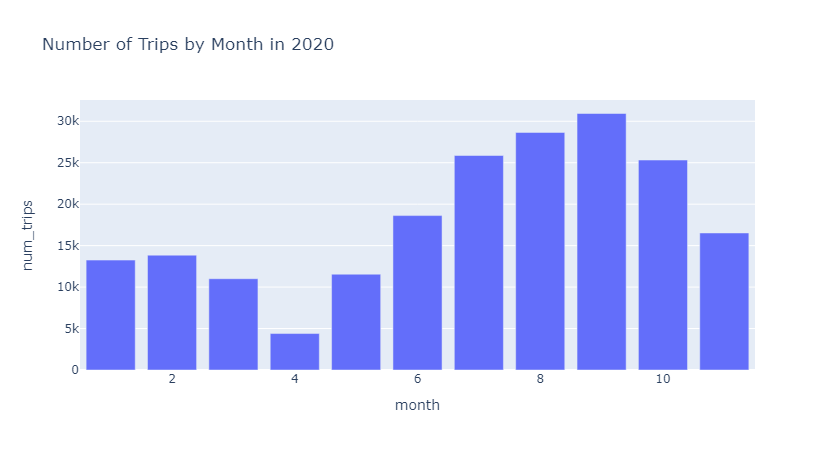

In [28]:
# YOUR CODE BEGINS
fig = px.bar(df_num_trips_by_month, x='month', y='num_trips', title='Number of Trips by Month in 2020')
fig.show()
# YOUR CODE ENDS

#### 🧭 Check your work

- Once you're done, run the code cell below to test correctness.
- ✔️ If the code cell runs without an error, you're good to move on.
- ❌ If the code cell throws an error, go back and fix incorrect parts.

In [29]:
tc.assertEqual(len(fig.data), 1, 'There must be only one plot in your figure')
tc.assertIsNotNone(fig.layout.title.text, 'Missing figure title')
tc.assertEqual(fig.data[0].type, 'bar', 'Must be a bar chart')
tc.assertEqual(fig.data[0].orientation, 'v', 'Your plot should have a vertical orientation')
np.testing.assert_array_equal(fig.data[0].x, df_num_trips_by_month['month'], 'Incorrect x-axis data')
np.testing.assert_array_equal(fig.data[0].y, df_num_trips_by_month['num_trips'], 'Incorrect y-axis data')